#Imports


In [1]:
!pip install pydub 
!pip install imbalanced-learn
!pip install keras

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [2]:
from google.colab import drive
drive.mount('/content/drive')

project_folder= "drive/MyDrive/team_10"

import pandas as pd
import numpy as np
import os 
import pickle
from scipy.fft import fft, fftfreq
import matplotlib.pyplot as plt 
import random 

def make_folder(fold):
  if not os.path.exists(fold):
    os.makedirs(fold)

Mounted at /content/drive


#FFT exctraction

Χρησιμοποιόντας τα δεδομένα από [1], και πιό συγκεκριμένα την ηχογράφηση ύπνου ατόμων που εμφανίζουν συμβάντα υπνικής άπνοιας,  θα προσπαθήσουμε να φτιάξουμε μοντέλα μηχανικής μάθησης, τα οποία, μόνο με την χρήση του ήχου, θα είναι σε θέση να καταλάβουν εάν ένα άτομο πάσχει ή όχι. Αυτό θα τα κάνει κατάλληλα για την χρήση από κινητά τηλέφωνα, κάτι στο οποίο σχεδόν όλοι έχουμε πρόσβαση

Για κάθε ασθενή έχουμε 5 αρχεία τύπου edf (European Data Foramt), μεγέθους ~ 600 MB. Με την χρήση του προγράμματος edfbrowser, κάνουμε export τα αρχεία σε μορφή csv, για να τα διαβάσουμε με την βιβλιοθήκη pandas. κάθε edf αρχείο μετατρέπεται σε ~ **8 GB**.

![picture](https://drive.google.com/uc?export=view&id=1ouCFNFWR0I9CFcwEAeSDyCIPP2bkitBQ)


Εδώ βλέπουμε πως διαβάζουμε  τις πρώτες 1.000.000 γραμμές. Μας ενδιαφέρει η στήλη 19, που έχει το μιρκόφωνο.



![picture](https://drive.google.com/uc?export=view&id=1LDSMg4sKe_dQa9bXAw4_yR_kHKIBEqt1)



In [3]:
data = pd.read_csv('drive/MyDrive/team_10/patient_00000995-100507/csv_data/00000995-100507[001]_data.txt', nrows=10**6)
print(data.shape)
data.head()

(1000000, 21)


,Time,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,20
0,0.000000,0.004776,0.004776,0.004776,0.004776,0.004776,0.00119,0.00119,0.00119,0.127153,...,0.001526,0.001526,0.001526,0.001526,0.001526,0.0,0.0,0.0,0.032547,0.002731
1,0.000021,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.032822,0.003433
2,0.000042,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.033341,0.002945
3,0.000063,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.033799,0.003098
4,0.000083,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.034043,0.002274


Προφανώς δεν μπορούμε να φορτώσουμε στην RAM 5 * 8 = 40 GB για κάθε ασθενή, οπότε θα πρέπει να τα χειριστούμε έξυπνα. Αυτό που θα κάνουμε είναι να φτιάξουμε έναν generator, ο οποίος θα διαβάζει 10^6 γραμμές (περίπου 20.8 δευτερόλεπτα) Ο λόγος που διαλέξαμε 20 δευτερόλεπτα είναι καθώς το μεγαλύτερο event που παρατηρήσαμε ήταν τόσης διάρκειας και θέλαμε ένα διάστημα να έχει την δυνατότητα να περιέχει ολόκληρο το event. Στην συνέχεια θα κάνουμε μετασχηματισμό Fourier, αφήνοντας μας έτσι ένα array με 3000, άπο 1 εκατομμύριο τιμές. Θα αποθηκεύσουμε το np array, μαζί με την χρονική περίοδο που αντιπροσοπεύει.


Με τις δύο παρακάτω συναρτήσεις θα μετρήσουμε τις σειρές του κάθε csv αρχείου, απαραίτητο 

In [4]:
def count_gen(input_file):
    for row in open(input_file,'r'):
        yield row

In [5]:
def count_rows(input_file):
  count = 0
  for row in count_gen(input_file):
          count+=1
  return count

Η dump_fft_information, θα λάβει ως όρισμα ένα datafram με 10 ^6 σειρές , τις συχνότητες που θα συμπεριλάβουμε στην fft(3000) ,τον φάκελο που θα τα αποθηκεύσει καθώς και την μεταβλητή time_offset, η οποία βρίσκεται εκεί, καθώς από αρχείο σε αρχείο, μηδενίζεται η στήλη Time, ενώ στην πραγματικοτητα, το ένα αρχείο είναι η συνέχεια του άλλου. 

In [6]:
def dump_fft_information(data,frequencies,file,time_offset):
    information = {}
    # fft
    yf = fft(np.array(data[19]))
    information['fft'] =2.0/frequencies *np.abs(yf[0:frequencies//2])
    # get the time of the first element
    information["period_start"] = data[0].iloc[0]+time_offset
    # get the time of the last element
    information["period_end"] = data[0].iloc[-1]+time_offset
    with open(file, 'wb') as fp:
      pickle.dump(information, fp)

Ο generator, θα λάβει 

**input_file**              : το αρχείο από τον οποίο θα διαβάσει τα δεδομένα

**trial**                   : σε ποιό αρχείου του ίδιου ασθενή είμαστε ([001], [002] , ...)

**target_folder**           : τον φάκελο στον οποίο θα παοθηκεύσει τα αποτελέσματα


**patient** : κωδικός ασθενή

**frequencies** : συχνότητες που θέλουμε να έχουμε στην fft

**rows_in_each_sample** : γραμμές ανά δείγμα

**batches**: πόσα ολόκληρα δείγματα

**leftovers** : οι γραμμές που περισεύουν

**skiprows** : σε περίπτωση που θέλουμε να συνεχίσουμε την εκτέλεση από την μέση του dataset



*θα παράξει*

**True** : άμα κάλεσε την dump_fft_information και αποθήκευσε κάποιον fft

**False** : εάν έχει τελειώσε και με τα batches και με τα leftovers, για να σταματήσουμε την επανάληψη



In [7]:
def fft_generator(input_file,trial,target_folder,patient,frequencies,rows_in_each_sample,batches,leftovers,skiprows=0):
  n = rows_in_each_sample
  total_rows = batches * rows_in_each_sample
  #each trial is an hour long
  time_offset = (int(trial)-1) *3600
  # the first time we take the header from the file
  data = pd.read_csv(input_file, nrows=n,skiprows=1,header=None)
  dump_fft_information(data,frequencies,target_folder+ '/'+ patient + '_ffts_0.pkl',time_offset)
  # and return true so the genetatro knows that there is more to come
  yield True

  # we repeate the same for all the rows
  skiprows = skiprows+ n 
  while skiprows < total_rows :

    # header = NONE cause we read from the middle of the file
    data = pd.read_csv(input_file, nrows=n,skiprows=skiprows,header=None)
    filename =target_folder + '/'+ patient + '_ffts_' +str(int(skiprows/rows_in_each_sample))+'.pkl'
    dump_fft_information(data,frequencies,filename,time_offset)
    skiprows = skiprows+ n 
    yield  True
  # now we just have to read the the leftovers


  if leftovers > 100:

    information = {}
    data = pd.read_csv(input_file, nrows=leftovers,skiprows=skiprows,header=None)
    filename = target_folder + '/'+ patient + '_ffts_' +str(1+int(skiprows/rows_in_each_sample))+'.pkl'
    dump_fft_information(data,frequencies,filename,time_offset)
    yield  False
  #so it does not crash
  while True:
    yield False



Με την perform_ffts_on_csv δεν κάνουμε τίποτα καινούργιο, απλά καλούμε τον generator με όλους τους ασθενής και trials που θέλουμε να μετασχηματίσουμε

In [8]:
# nothing new, a helper function that calls every important cell from above, so we dont have to run everything
def perform_ffts_on_csv(patients,trials,rows_in_each_sample = 10**6,frequencies = 6000):
  for patient in patients:
    patient_folder = project_folder+ "/patient_" + patient
    make_folder(patient_folder)
    csv_data_folder = patient_folder + '/csv_data'
    make_folder(csv_data_folder)

    for trial in trials:
      data_filename = csv_data_folder+ '/'+ patient + '['+trial+']' +'_data.txt'
      # folder to  store the ffts 
      ffts_folder = patient_folder + '/ffts'
      make_folder(ffts_folder)

      ffts_trial_folder = ffts_folder +'/'+trial
      make_folder(ffts_trial_folder)

      count = count_rows(data_filename)
      batches = int(count /rows_in_each_sample)
      leftovers = count%(batches *rows_in_each_sample) - 1 

      g = fft_generator(data_filename,trial,ffts_trial_folder,patient,frequencies,rows_in_each_sample,batches,leftovers)

      while(next(g)):
        pass

In [9]:
patients = ['00001000-100507','00000999-100507','00000995-100507']
trials = ['001','002','003','004','005']

In [10]:
#perform_ffts_on_csv(patients,trials)

# RML decode

Τα labels θα τα αντλήσουμε από τα αρχεία rml, που παρέχονται από το ίδιο άρθρο. Μοιάζουν πολύ με τα XML και για εμάς είναι απλά μίας σειρά από string, οπότε δεν θα αναλύσουμε πως εξάγουμε την πληροφορία.




![picture](https://drive.google.com/uc?export=view&id=16kr-0SSAWarJmQdwVCLGBCpjqFOtQQeP)




In [11]:
def my_filter(word):
  filtered_word = []
  for letter in word:
    if (letter >= '0'  and letter <= '9') or letter == '.':
      filtered_word.append(letter)
  return ''.join(filtered_word)


In [12]:
def find_apnea_events(patient):
  patient_folder = project_folder+ "/patient_" + patient
  rml_file = patient_folder+"/"+patient+'.rml'
  
  search_term = "Apnea"
  apnea_events  = pd.DataFrame(columns=['Start','Duration'])

  with open(rml_file) as f:
    for line in f:
      if search_term in line and "Start" in line and "Duration" in line:
        for element in line.split(" "):
          if "Start" in element:
            startTime = float(my_filter(element))
          if "Duration" in element:
            Duration = float(my_filter(element))
          
        apnea_events = apnea_events.append({"Start": startTime,"Duration":Duration},ignore_index = True)

  return apnea_events

In [80]:
sample_apnea_events = find_apnea_events('00000995-100507')
print(sample_apnea_events.shape)
sample_apnea_events.head()

(80, 2)


,Start,Duration
0,4242.0,10.0
1,4623.5,11.0
2,5422.5,11.0
3,5589.0,11.0
4,6851.0,12.0


Βλέπουμε τις διάρκειες των συμβάντων του πρώτου ασεθνούς ( δεν είναι sorted)

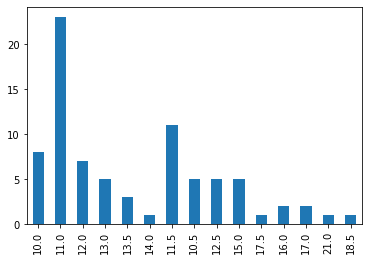

In [14]:
sample_apnea_events['Duration'].value_counts(sort=False).plot(kind='bar');

Και τα χρονικά περιθώρια που συμβαίνουν σε λεπτά

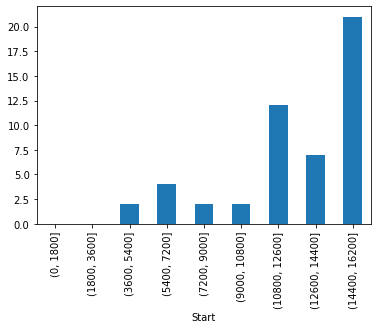

In [15]:
total_duration = 18000
ranges = np.arange(0,total_duration,total_duration/10,dtype=int)
sample_apnea_events.groupby(pd.cut(sample_apnea_events['Start'], ranges)).count()['Start'].plot(kind='bar');

#Label ffts with apnea events

Έχοντας εξάγει τα ffts και τα σημεία που συμβαίνουν, το μόνο που μένει είναι να κάνουμμε την αντιστοίχιση. Μία σχεδιατική επιλογή που κάναμε είναι ότι αποφασήσαμε πως εάν ενα apnea event έχει τουλάχιστον 5 δευτερόλεπτα σε ένα fft θεωρούμε ότι είναι labeled 1.

Δέχεται τα samples και apnea evetns, για έναν ασθενή

In [16]:
def match_apnea_events_to_samples(samples,apnea_events,min_overlap = 5):
  apnea_pointer = 0
  for i in range(len(samples)-1):
    next_apnea_event  = False
    if samples[i]['period_end'] - min_overlap> apnea_events['Start'][apnea_pointer] :
      samples[i]['label'] = 1
      next_apnea_event = True

    if apnea_events['Start'][apnea_pointer]+ apnea_events['Duration'][apnea_pointer] - samples[i]['period_end'] >min_overlap and samples[i]['period_end'] >apnea_events['Start'][apnea_pointer] :
      samples[i+1]['label'] = 1
      next_apnea_event = True
    if next_apnea_event:
      if apnea_pointer < apnea_events.shape[0]-1:
        apnea_pointer = apnea_pointer+1
      else:
        break




Διαβάζει όλα τα ffts ενός ασθενή

In [17]:
def get_single_patient_ffts(patient_folder):
  patient_ffts = []
  apnea_events = find_apnea_events(patient_folder[8:])
  ffts_folder = project_folder+'/'+patient_folder+'/ffts'

  if os.path.isdir(ffts_folder):
    for trial in os.listdir(ffts_folder):
      for fft in os.listdir(ffts_folder+'/'+trial):
        with open(ffts_folder+'/'+trial+'/'+fft,'rb') as file:
          x = pickle.load(file)
          x['label'] = 0
          patient_ffts.append(x)
    patient_ffts = sorted(patient_ffts, key=lambda d: d['period_start'],reverse=False) 
    match_apnea_events_to_samples(patient_ffts,apnea_events)

  return patient_ffts

το κάνει για όλους

In [18]:
def create_fft_dataset():
  ffts = []
  for patient_folder in  os.listdir(project_folder):
    patient_ffts = get_single_patient_ffts(patient_folder)
    ffts = ffts + patient_ffts
  Xs = []
  ys = []
  for f in ffts:
    Xs.append(f['fft'])
    ys.append(f['label'])
  return Xs, ys

#Machine Learning models

Έχοντας λοιπόν το dataset μας, θα δοκιμάσουμε διάφορους Classifiers.

In [19]:
from sklearn.model_selection import train_test_split

from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neural_network import MLPClassifier
from sklearn.svm import SVC

from sklearn.metrics import recall_score
from sklearn.metrics import precision_score
from sklearn.metrics import f1_score

Βοηθητική συνάρτηση για να μην κάνουμε copy paste

In [20]:
def train_test_clf(clf,X_train, X_test, y_train, y_test):
  clf.fit(X_train, y_train)
  accuracy= clf.score(X_test,y_test)
  preds = clf.predict(X_test)
  recall = recall_score(y_test,preds)
  precision =precision_score(y_test,preds)
  f1_micro = f1_score(y_test, preds, average='micro')
  f1_macro = f1_score(y_test, preds, average='macro')

  
  print('Accuracy     :   ',accuracy)
  print('Recall       :   ',recall)
  print('Precision    :   ',precision)
  print('F1 micro     :   ',f1_micro)
  print('F1 macro     :   ',f1_macro)

  X_axis = ['accuracy','recall','precision','F1 micro','F1 macro']

  plt.bar(X_axis,[accuracy,recall,precision,f1_micro,f1_macro])
  plt.ylim(0,1)
  plt.show()

##Chose clfs

Διαλέγουμε του clfs που θέλουμε να κάνουμε test

In [21]:
clfs = {
  "GaussianNB" :GaussianNB(),
  "MLP":MLPClassifier(random_state=1, max_iter=300),
  "SVC":SVC()
}
neighbors = [1,3,5,7,9,11]

for k in neighbors:
  clfs['KNeighbors k='+str(k)] = KNeighborsClassifier(n_neighbors=k)

In [22]:
def test_clfs(X_train, X_test, y_train, y_test,labels,clfs):
  for clf_name in clfs:
    print('************************************************************************************')
    print('Classifier   :   ',clf_name)
    train_test_clf(clfs[clf_name],X_train, X_test, y_train, y_test)
    print('************************************************************************************')


************************************************************************************
Classifier   :    GaussianNB
Accuracy     :    0.562992125984252
Recall       :    0.7575757575757576
Precision    :    0.24937655860349128
F1 micro     :    0.562992125984252
F1 macro     :    0.5196051518071652


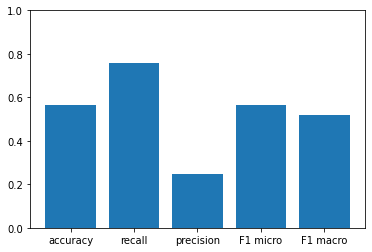

************************************************************************************
************************************************************************************
Classifier   :    MLP


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


Accuracy     :    0.7847769028871391
Recall       :    0.1590909090909091
Precision    :    0.28378378378378377
F1 micro     :    0.7847769028871391
F1 macro     :    0.5397262695758505


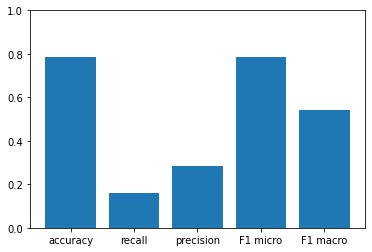

************************************************************************************
************************************************************************************
Classifier   :    SVC
Accuracy     :    0.8267716535433071
Recall       :    0.0
Precision    :    0.0
F1 micro     :    0.8267716535433071
F1 macro     :    0.45258620689655177


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


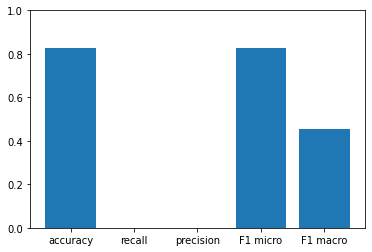

************************************************************************************
************************************************************************************
Classifier   :    KNeighbors k=1
Accuracy     :    0.7572178477690289
Recall       :    0.32575757575757575
Precision    :    0.30935251798561153
F1 micro     :    0.757217847769029
F1 macro     :    0.5848487614963939


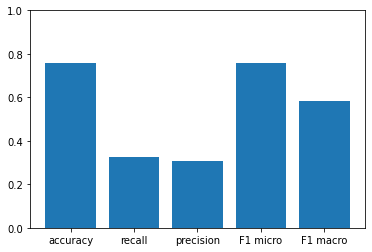

************************************************************************************
************************************************************************************
Classifier   :    KNeighbors k=3
Accuracy     :    0.7847769028871391
Recall       :    0.26515151515151514
Precision    :    0.3431372549019608
F1 micro     :    0.7847769028871391
F1 macro     :    0.5860067580997814


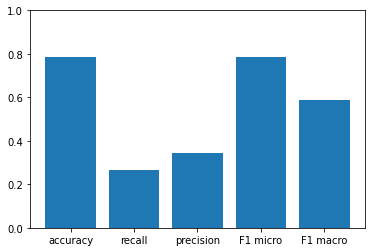

************************************************************************************
************************************************************************************
Classifier   :    KNeighbors k=5
Accuracy     :    0.7874015748031497
Recall       :    0.1893939393939394
Precision    :    0.3125
F1 micro     :    0.7874015748031495
F1 macro     :    0.556186723423838


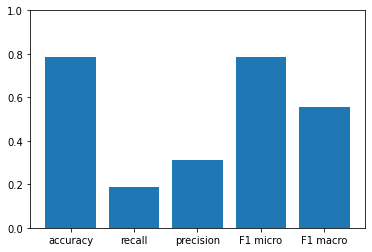

************************************************************************************
************************************************************************************
Classifier   :    KNeighbors k=7
Accuracy     :    0.7926509186351706
Recall       :    0.13636363636363635
Precision    :    0.2903225806451613
F1 micro     :    0.7926509186351706
F1 macro     :    0.5333850089140377


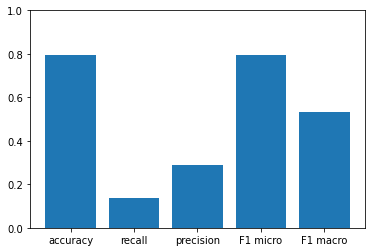

************************************************************************************
************************************************************************************
Classifier   :    KNeighbors k=9
Accuracy     :    0.8031496062992126
Recall       :    0.12878787878787878
Precision    :    0.3269230769230769
F1 micro     :    0.8031496062992126
F1 macro     :    0.5364211550940947


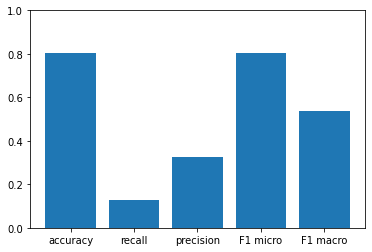

************************************************************************************
************************************************************************************
Classifier   :    KNeighbors k=11
Accuracy     :    0.8070866141732284
Recall       :    0.10606060606060606
Precision    :    0.32558139534883723
F1 micro     :    0.8070866141732284
F1 macro     :    0.5255151964418088


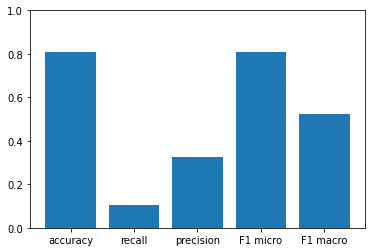

************************************************************************************


In [81]:
X, labels = create_fft_dataset()

X_train, X_test, y_train, y_test = train_test_split(X, labels, test_size=0.33, random_state=42)
test_clfs(X_train, X_test, y_train, y_test,labels,clfs)

##Balance dataset


Ένα πρόβλημα που ίσως έχουμε είναι ότι έχουμε πολύ λίγα περιστατικά άπνοιας σε σχέση με μή. Φτάνει να παρατηρήσουμε ότι το sample_apnea_events έχει μόνο 80 στήλες, ενώ έχουμε περίπου 1000
 ffts. Για αυτό θα προσπαθήσουμε να το κάνουμε balance

In [82]:
from imblearn.over_sampling import RandomOverSampler

In [83]:
oversample = RandomOverSampler(sampling_strategy='minority')
X, labels  = create_fft_dataset()
X_train, X_test, y_train, y_test = train_test_split(X, labels, test_size=0.33, random_state=42)

X_train_resampled, y_train_resampled = oversample.fit_resample(X_train, y_train)

************************************************************************************
Classifier   :    GaussianNB
Accuracy     :    0.5643044619422573
Recall       :    0.7651515151515151
Precision    :    0.2512437810945274
F1 micro     :    0.5643044619422573
F1 macro     :    0.5214618091022586


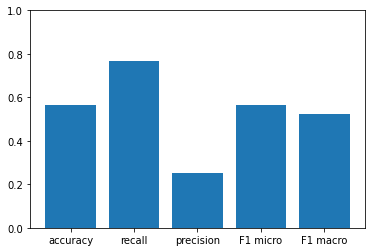

************************************************************************************
************************************************************************************
Classifier   :    MLP
Accuracy     :    0.7427821522309711
Recall       :    0.30303030303030304
Precision    :    0.2777777777777778
F1 micro     :    0.7427821522309712
F1 macro     :    0.5664018952062431


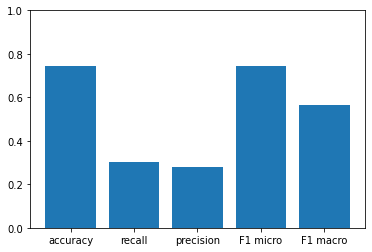

************************************************************************************
************************************************************************************
Classifier   :    SVC
Accuracy     :    0.520997375328084
Recall       :    0.9015151515151515
Precision    :    0.2526539278131635
F1 micro     :    0.520997375328084
F1 macro     :    0.4991924200928042


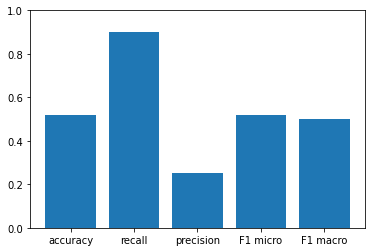

************************************************************************************
************************************************************************************
Classifier   :    KNeighbors k=1
Accuracy     :    0.7572178477690289
Recall       :    0.32575757575757575
Precision    :    0.30935251798561153
F1 micro     :    0.757217847769029
F1 macro     :    0.5848487614963939


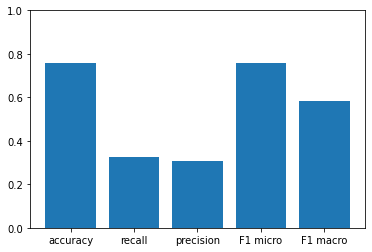

************************************************************************************
************************************************************************************
Classifier   :    KNeighbors k=3
Accuracy     :    0.6863517060367454
Recall       :    0.4772727272727273
Precision    :    0.2703862660944206
F1 micro     :    0.6863517060367454
F1 macro     :    0.5694966137553631


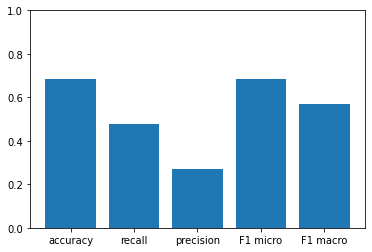

************************************************************************************
************************************************************************************
Classifier   :    KNeighbors k=5
Accuracy     :    0.6548556430446194
Recall       :    0.5833333333333334
Precision    :    0.27017543859649124
F1 micro     :    0.6548556430446194
F1 macro     :    0.5658627569489124


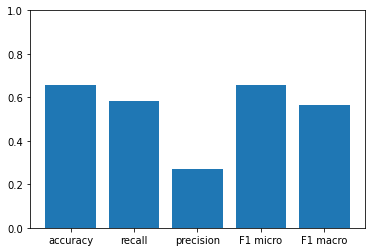

************************************************************************************
************************************************************************************
Classifier   :    KNeighbors k=7
Accuracy     :    0.6430446194225722
Recall       :    0.6742424242424242
Precision    :    0.279874213836478
F1 micro     :    0.6430446194225722
F1 macro     :    0.5711483550589695


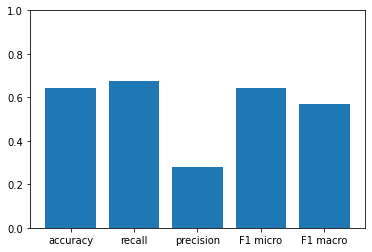

************************************************************************************
************************************************************************************
Classifier   :    KNeighbors k=9
Accuracy     :    0.6482939632545932
Recall       :    0.7045454545454546
Precision    :    0.2888198757763975
F1 micro     :    0.6482939632545932
F1 macro     :    0.5796121701181605


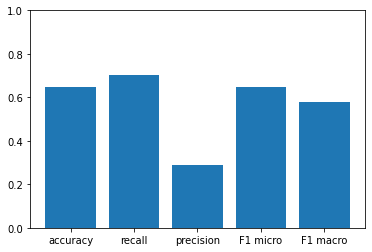

************************************************************************************
************************************************************************************
Classifier   :    KNeighbors k=11
Accuracy     :    0.6561679790026247
Recall       :    0.696969696969697
Precision    :    0.2929936305732484
F1 micro     :    0.6561679790026247
F1 macro     :    0.5847566910987795


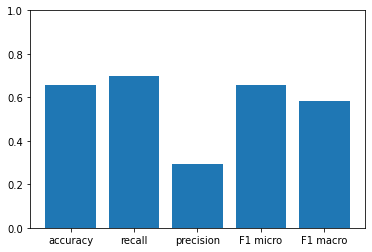

************************************************************************************


In [84]:
test_clfs(X_train_resampled, X_test, y_train_resampled, y_test,labels,clfs)

Βλέπουμε καλύτερα αλλά όχι ικανοποιητικα αποτελέσματα. Για να προσπαθήσουμε να βελτιώσουμε τους ταξινομηετές μας, θα οπτικοποιήσουμε τους μετασχηματισμους Fourier

### Visualisation

Για να έχουμε μία καλύτερη εικόνα του τι κάνουμε θα οπτικοποιήσουμε τους ffts 

In [85]:
def plot_fft(fft):
    N = len(fft) *2
    T = 1/N
    xf = fftfreq(N, T)[:N//2]
    plt.plot(xf, fft)
    plt.grid()
    plt.show()

In [86]:
def plot_random_samples(X,labels):
  print("Samples with apnea events")
  print("**********************************************************************")
  for i in range(len(X)):
  # in order to get random samples and not just the first ones
    if random.randrange(100) > 90:
      if labels[i] ==1:
        plot_fft(X[i])
  print("**********************************************************************")
  print("**********************************************************************")
  print("Samples without apnea events")
  print("**********************************************************************")  
  print("**********************************************************************")
  for i in range(len(X)):
    # in order to get random samples and not just the first ones
    if random.randrange(10000) > 9900:
      if labels[i] ==0:
        plot_fft(X[i])



In [87]:
X, labels  = create_fft_dataset()

Samples with apnea events
**********************************************************************


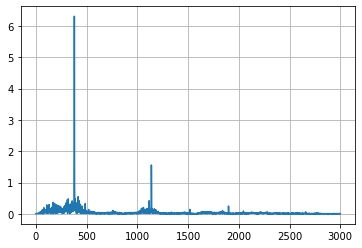

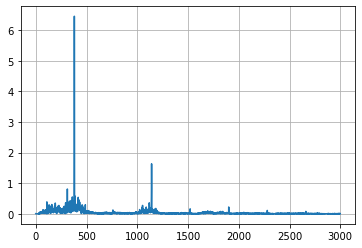

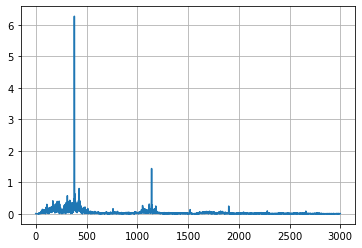

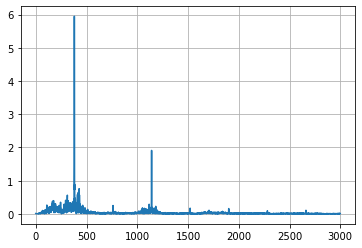

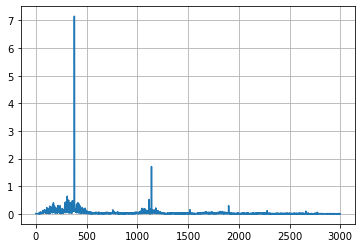

...

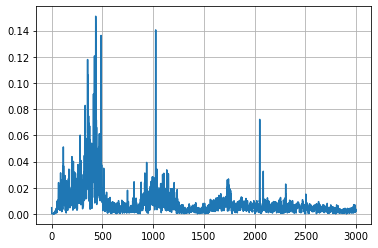

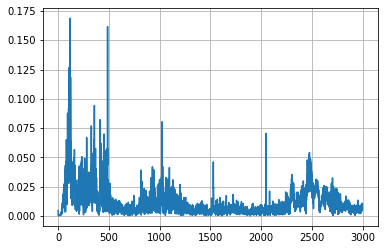

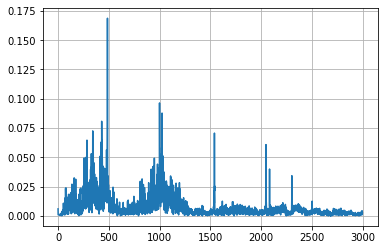

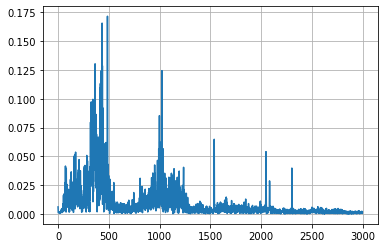

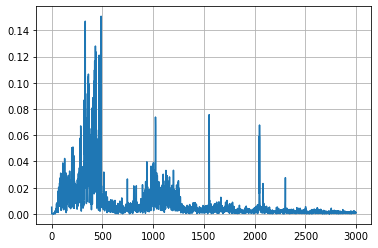

**********************************************************************
**********************************************************************
Samples without apnea events
**********************************************************************
**********************************************************************


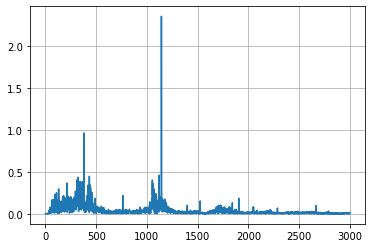

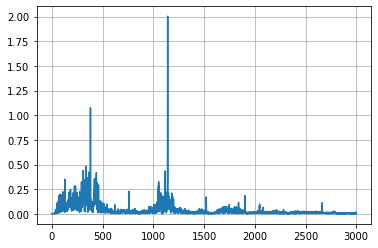

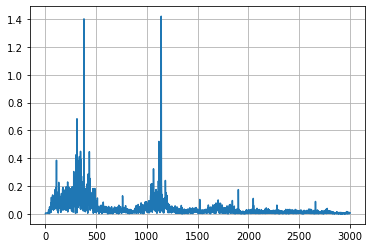

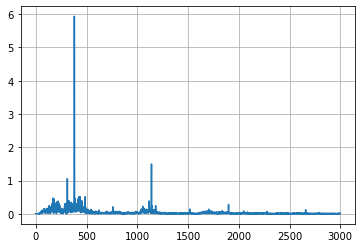

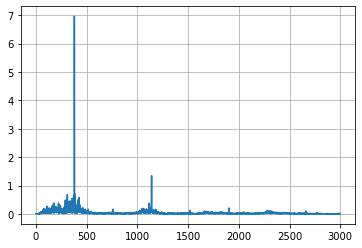

...

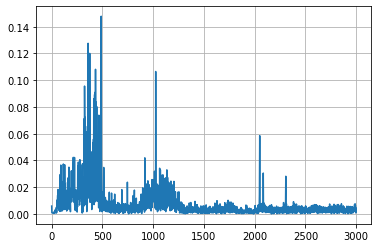

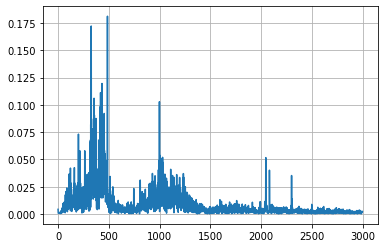

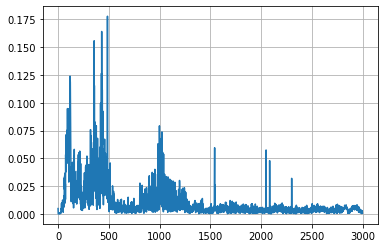

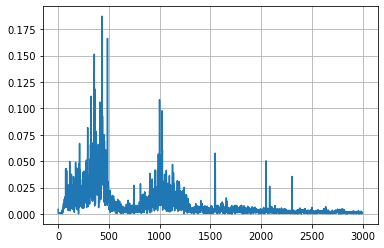

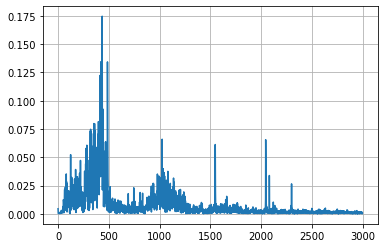

In [88]:
plot_random_samples(X,labels)

Αυτό που παρατηρήσαμε είναι ότι σε κάποια δείγματα, είτε με συμβάν είτε όχι, υπάρχουν μερικές συχνότητες οι οποίες επισκιάζουν όλες τις άλλες. Πέρα από πολύ πιο ισχυρές, είναι και μεμονομένες. 

Περίπτωρση που δυμβαίνει αυτό το φαινόμενο


![picture](https://drive.google.com/uc?export=view&id=15oFHpvjaYx7WB3ZN-vAKIt19eQIDgZBz)


Περίπτωρση που **ΔΕΝ** δυμβαίνει αυτό το φαινόμενο


![picture](https://drive.google.com/uc?export=view&id=1YRobtLVxt4KnBD7FgulKEo7Qk5tcOBW3)







 Για να καταλάβουμε καλύτερα τι συμβαίνει, αναζητήσαμε το φάσμα του ροχαλητού και βρήκαμε τα εξής διαγράμματα, για 5 δευτερόλεπτα

![picture](https://drive.google.com/uc?export=view&id=1blFEET7n0uUl8nLdLUxIMRVwo1bN0owa)



Ενώ βλέπουμε αντίστοιχη συμπεριφορά στον συνολικό χρόνο




![picture](https://drive.google.com/uc?export=view&id=1lHEKQnAjHDRZQVGupY2Y2mcVHUZu7TqB)



Είναι ξεκάθαρο ότι η δεύτερη περίπτωση ταιριάζει καλύτερα στις μετρήσεις. Υποθέτουμε ότι αυτές οι πολύ ισχευρές και περιορισμένες συχνότητες προέρχονται από κάποιο μηχάνημα που βρίσκεται στον χώρο. Για αυτό θα προσπαθήσουμε να τις κόψουμε

## Remove most frequent peaks

Αρχικά θα προσπαθήσουμε να κόψουμε τις πιό συχνές κορυφές

In [89]:
X, labels = create_fft_dataset()

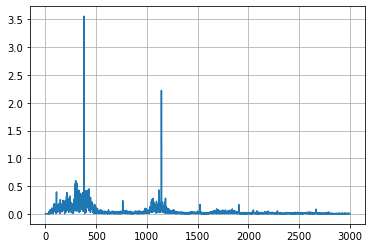

In [90]:
plot_fft(X[0])

In [91]:
def locate_most_frequent_peaks(samples):
  peaks_counter ={}

  for sample in samples:
    peak = np.argmax(sample)
    if peak not in peaks_counter:
      peaks_counter[peak] = 1
    else:
      peaks_counter[peak] = peaks_counter[peak] + 1
      
  return dict(sorted(peaks_counter.items(), key=lambda item: item[1],reverse=True))


In [92]:
def remove_most_frequent_peaks(frequencies_dict,samples,cut_off_percentage =0.0175):
  sample_len = len(samples)
  found_peak = False
  for i  in range(len(samples)):
    for freq in frequencies_dict:
      if frequencies_dict[freq] / sample_len >  cut_off_percentage:
        samples[i][freq] = 0
        found_peak = True

  return found_peak

In [93]:
def remove_all_frequent_peaks(X):
  while(remove_most_frequent_peaks(locate_most_frequent_peaks(X),X)):
    pass

In [94]:
remove_all_frequent_peaks(X)

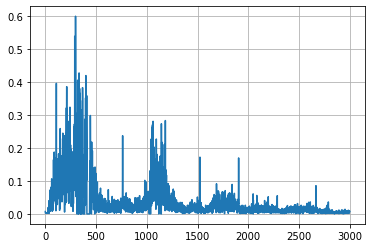

In [95]:
plot_fft(X[0])

Samples with apnea events
**********************************************************************


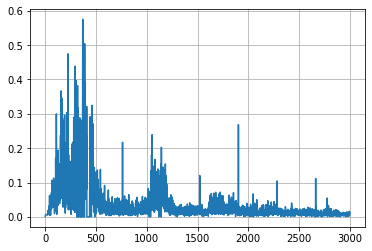

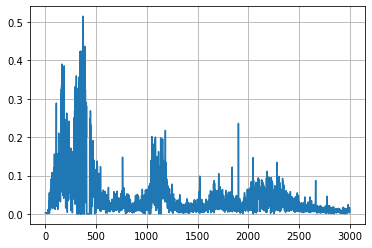

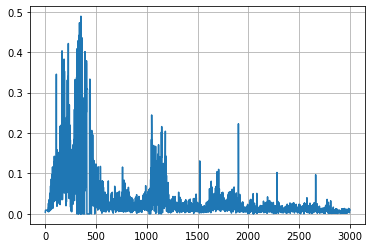

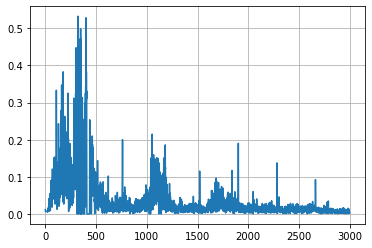

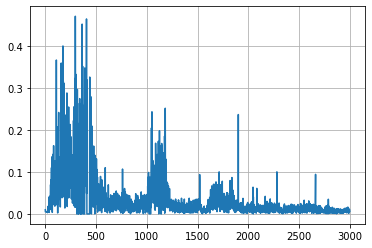

...

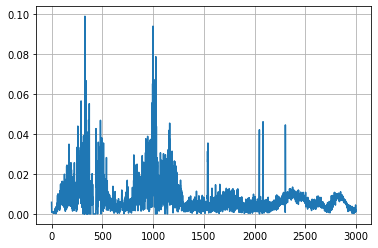

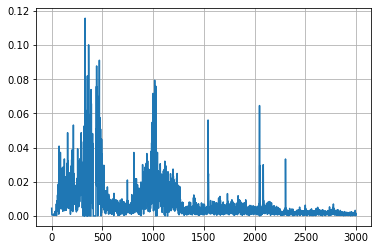

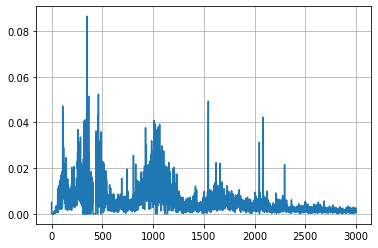

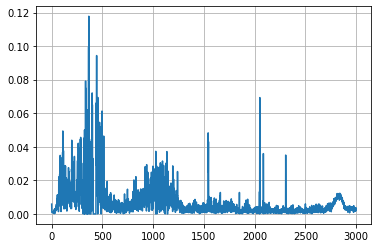

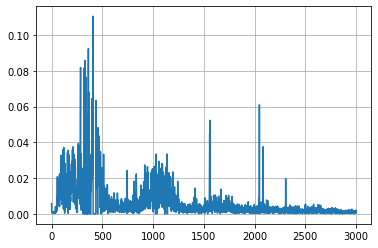

**********************************************************************
**********************************************************************
Samples without apnea events
**********************************************************************
**********************************************************************


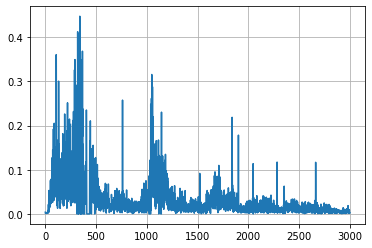

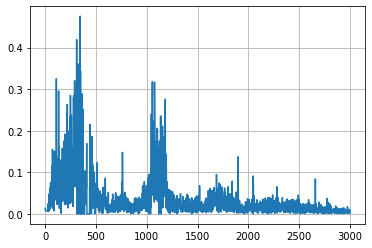

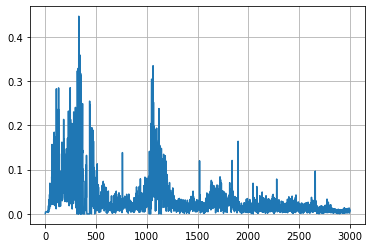

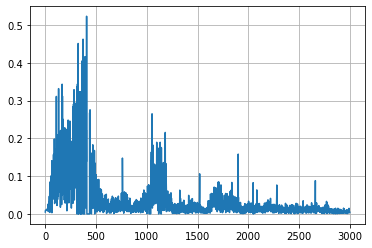

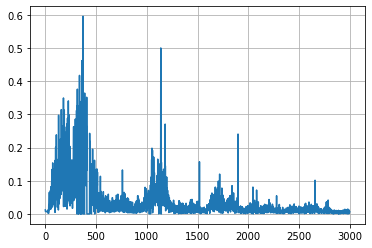

...

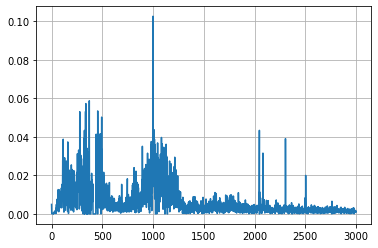

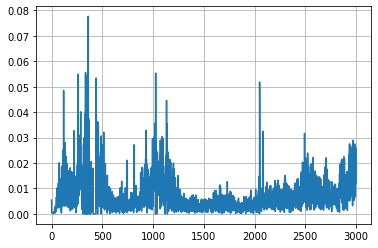

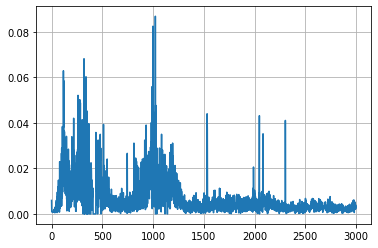

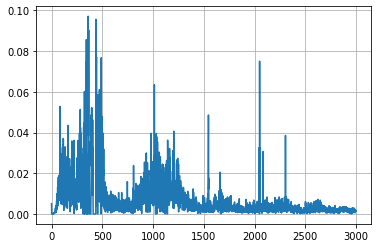

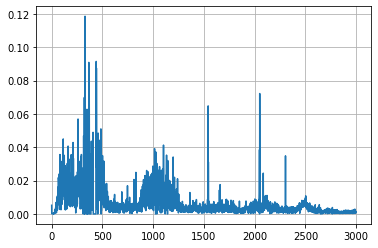

In [96]:
plot_random_samples(X,labels)

Τα αποτελέσματά μας, τουλάχιστον οπτικά μοιάζουν πολύ περισσότερο με αυτά που περιμέναμε, αλλά υπάρχουν ακόμα peaks που δεν εξηγούνται. 




![picture](https://drive.google.com/uc?export=view&id=1YhY8wyoImmSHiGTndx34UtbKnV4LshMj)


************************************************************************************
Classifier   :    GaussianNB
Accuracy     :    0.562992125984252
Recall       :    0.7651515151515151
Precision    :    0.2506203473945409
F1 micro     :    0.562992125984252
F1 macro     :    0.5204331761526322


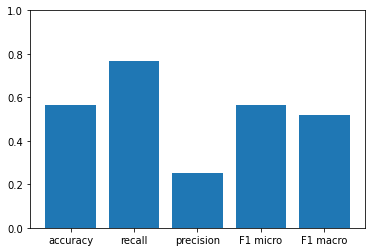

************************************************************************************
************************************************************************************
Classifier   :    MLP
Accuracy     :    0.7572178477690289
Recall       :    0.29545454545454547
Precision    :    0.29770992366412213
F1 micro     :    0.757217847769029
F1 macro     :    0.574934492813055


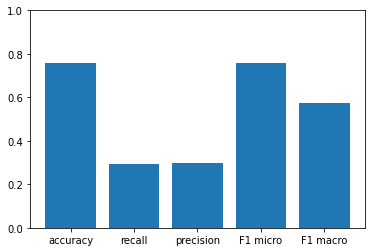

************************************************************************************
************************************************************************************
Classifier   :    SVC
Accuracy     :    0.5603674540682415
Recall       :    0.7803030303030303
Precision    :    0.25183374083129584
F1 micro     :    0.5603674540682415
F1 macro     :    0.5199914253962463


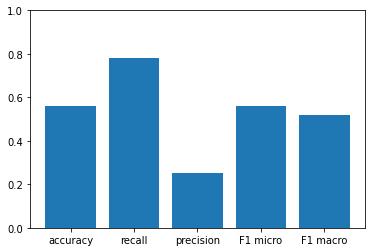

************************************************************************************
************************************************************************************
Classifier   :    KNeighbors k=1
Accuracy     :    0.7572178477690289
Recall       :    0.3484848484848485
Precision    :    0.31724137931034485
F1 micro     :    0.757217847769029
F1 macro     :    0.5918869546840214


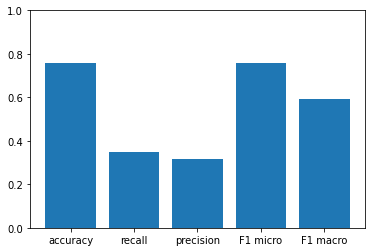

************************************************************************************
************************************************************************************
Classifier   :    KNeighbors k=3
Accuracy     :    0.6548556430446194
Recall       :    0.49242424242424243
Precision    :    0.24904214559386972
F1 micro     :    0.6548556430446194
F1 macro     :    0.5491256133530417


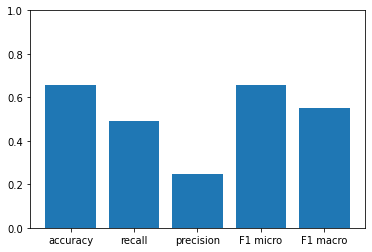

************************************************************************************
************************************************************************************
Classifier   :    KNeighbors k=5
Accuracy     :    0.6246719160104987
Recall       :    0.6136363636363636
Precision    :    0.2563291139240506
F1 micro     :    0.6246719160104987
F1 macro     :    0.5479039431757833


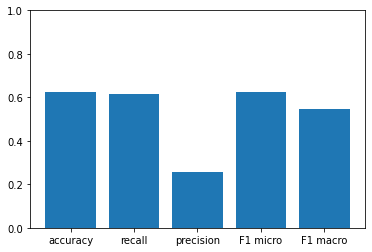

************************************************************************************
************************************************************************************
Classifier   :    KNeighbors k=7
Accuracy     :    0.5958005249343832
Recall       :    0.6515151515151515
Precision    :    0.2471264367816092
F1 micro     :    0.5958005249343832
F1 macro     :    0.5316570881226054


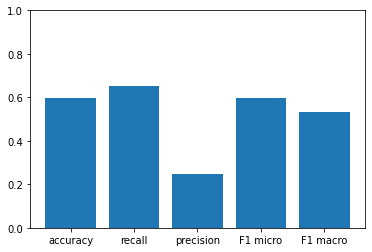

************************************************************************************
************************************************************************************
Classifier   :    KNeighbors k=9
Accuracy     :    0.594488188976378
Recall       :    0.6742424242424242
Precision    :    0.2507042253521127
F1 micro     :    0.594488188976378
F1 macro     :    0.5337640762030735


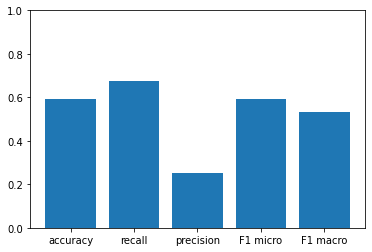

************************************************************************************
************************************************************************************
Classifier   :    KNeighbors k=11
Accuracy     :    0.6194225721784777
Recall       :    0.6363636363636364
Precision    :    0.25766871165644173
F1 micro     :    0.6194225721784777
F1 macro     :    0.5473835994658234


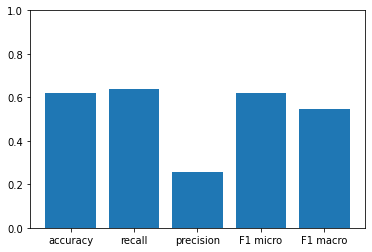

************************************************************************************


In [97]:
X_train, X_test, y_train, y_test = train_test_split(X, labels, test_size=0.33, random_state=42)

X_train_resampled, y_train_resampled = oversample.fit_resample(X_train, y_train)

test_clfs(X_train_resampled, X_test, y_train_resampled, y_test,labels,clfs)

## Remove isolated peaks

Για αυτό θα αλλάξουμε στρατηγικη και αντί για την συχνότητα, θα έχουμε κρητιριο αφαίρεσης το πόσο μοιάζει με τις γειτονικές κορυφές του.

In [98]:
X, labels  = create_fft_dataset()

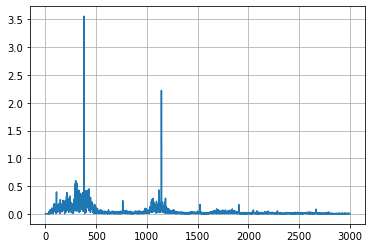

In [99]:
plot_fft(X[0])

In [100]:
def locate_isolated_peaks(values,width_margin=3,cutoff=0.7):
  isolated_peaks = []
  acc = 0.0000001 # so we dont divide by 0

  for j in range(2*width_margin+1):
      acc = acc +values[j]
   

  for i in range(width_margin, len(values)-width_margin):
    if values[i] /acc >cutoff:
      isolated_peaks.append(i)
    acc = acc - values[i-width_margin]
    acc = acc + values[i+width_margin]


  return isolated_peaks

In [101]:
def remove_isolated_peaks(samples,cutoff =0.5):
  for i in range(len(samples)):
    isolated = locate_isolated_peaks(samples[i],cutoff=cutoff)
    for j in isolated:
      samples[i][j] =0


In [102]:
remove_isolated_peaks(X)

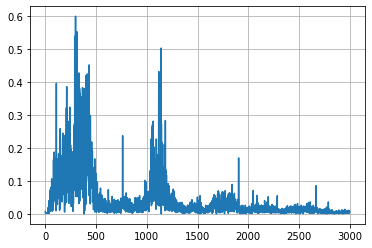

In [103]:
plot_fft(X[0])

In [104]:
X_train, X_test, y_train, y_test = train_test_split(X, labels, test_size=0.33, random_state=42)

X_train_resampled, y_train_resampled = oversample.fit_resample(X_train, y_train)

************************************************************************************
Classifier   :    GaussianNB
Accuracy     :    0.5643044619422573
Recall       :    0.7727272727272727
Precision    :    0.2524752475247525
F1 micro     :    0.5643044619422573
F1 macro     :    0.5222823131307028


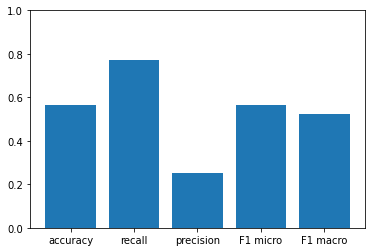

************************************************************************************
************************************************************************************
Classifier   :    MLP
Accuracy     :    0.7427821522309711
Recall       :    0.29545454545454547
Precision    :    0.2746478873239437
F1 micro     :    0.7427821522309712
F1 macro     :    0.5639357664233576


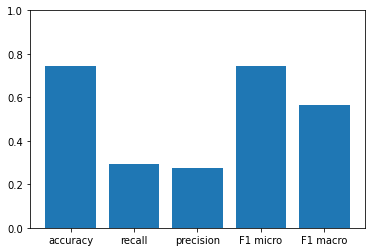

************************************************************************************
************************************************************************************
Classifier   :    SVC
Accuracy     :    0.526246719160105
Recall       :    0.8560606060606061
Precision    :    0.24835164835164836
F1 micro     :    0.526246719160105
F1 macro     :    0.4998681863717436


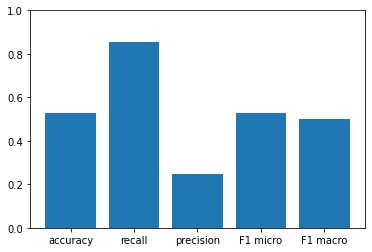

************************************************************************************
************************************************************************************
Classifier   :    KNeighbors k=1
Accuracy     :    0.7506561679790026
Recall       :    0.2878787878787879
Precision    :    0.2835820895522388
F1 micro     :    0.7506561679790026
F1 macro     :    0.5673404496933909


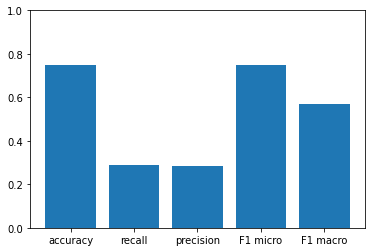

************************************************************************************
************************************************************************************
Classifier   :    KNeighbors k=3
Accuracy     :    0.6850393700787402
Recall       :    0.4166666666666667
Precision    :    0.25229357798165136
F1 micro     :    0.6850393700787402
F1 macro     :    0.5549282063762473


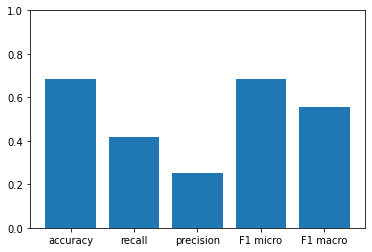

************************************************************************************
************************************************************************************
Classifier   :    KNeighbors k=5
Accuracy     :    0.6430446194225722
Recall       :    0.4621212121212121
Precision    :    0.23282442748091603
F1 micro     :    0.6430446194225722
F1 macro     :    0.5344683527244958


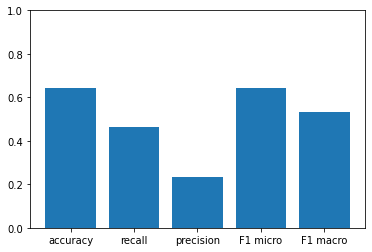

************************************************************************************
************************************************************************************
Classifier   :    KNeighbors k=7
Accuracy     :    0.6286089238845144
Recall       :    0.5606060606060606
Precision    :    0.24749163879598662
F1 micro     :    0.6286089238845144
F1 macro     :    0.5422335342179616


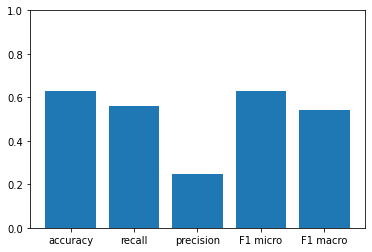

************************************************************************************
************************************************************************************
Classifier   :    KNeighbors k=9
Accuracy     :    0.6220472440944882
Recall       :    0.5833333333333334
Precision    :    0.24838709677419354
F1 micro     :    0.6220472440944882
F1 macro     :    0.541121268641112


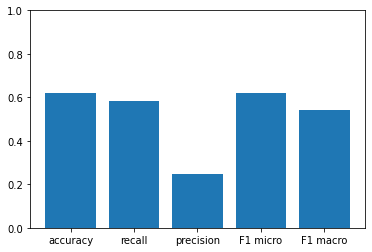

************************************************************************************
************************************************************************************
Classifier   :    KNeighbors k=11
Accuracy     :    0.6391076115485564
Recall       :    0.5757575757575758
Precision    :    0.2576271186440678
F1 micro     :    0.6391076115485564
F1 macro     :    0.5526441070921547


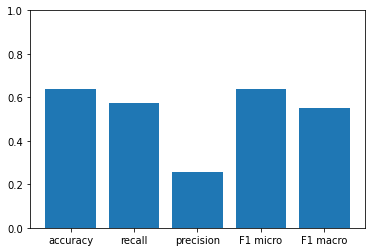

************************************************************************************


In [105]:
test_clfs(X_train_resampled, X_test, y_train_resampled, y_test,labels,clfs)

# single patient

Όταν κάναμε την ανάπτυξη και είχαμε μόνο έναν ασθενή, παρατηρήσαμε καλύτερα αποτελέσματα.

In [106]:
def test_single_patient(patient_folder,clfs):
  ffts  =get_single_patient_ffts(patient_folder)
  if(ffts):
    X = []
    labels = []
    for f in ffts:
      X.append(f['fft'])
      labels.append(f['label'])

    X_train, X_test, y_train, y_test = train_test_split(X, labels, test_size=0.33, random_state=42)
    test_clfs(X_train, X_test, y_train, y_test,labels,clfs)

    

In [107]:
def test_all_patients_seperately(clfs):
  patients = project_folder+''
  for patient_folder in os.listdir(patients):
    print('######################################################################################################')
    print('######################################################################################################')
    print("                                      For    ",patient_folder)
    print('######################################################################################################')
    print('######################################################################################################')
    test_single_patient(patient_folder,clfs)



In [108]:
clfs = {
  "GaussianNB" :GaussianNB(),
  'KNeighbors k=1' : KNeighborsClassifier(n_neighbors=1)
}

######################################################################################################
######################################################################################################
                                      For     patient_00000995-100507
######################################################################################################
######################################################################################################
************************************************************************************
Classifier   :    GaussianNB
Accuracy     :    0.6468531468531469
Recall       :    0.8888888888888888
Precision    :    0.19672131147540983
F1 micro     :    0.6468531468531469
F1 macro     :    0.5416884827137576


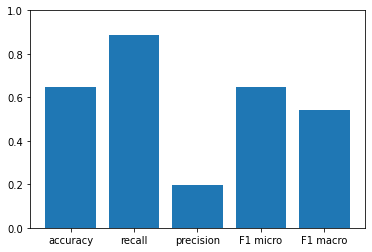

************************************************************************************
************************************************************************************
Classifier   :    KNeighbors k=1
Accuracy     :    0.8601398601398601
Recall       :    0.37037037037037035
Precision    :    0.30303030303030304
F1 micro     :    0.8601398601398601
F1 macro     :    0.6276041666666666


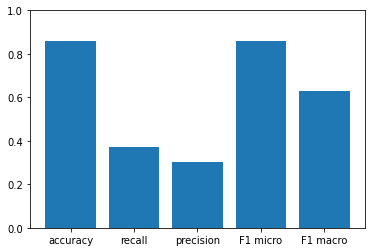

************************************************************************************
######################################################################################################
######################################################################################################
                                      For     patient_00000999-100507
######################################################################################################
######################################################################################################
************************************************************************************
Classifier   :    GaussianNB
Accuracy     :    0.4351464435146444
Recall       :    0.8787878787878788
Precision    :    0.31351351351351353
F1 micro     :    0.4351464435146444
F1 macro     :    0.43371886901732276


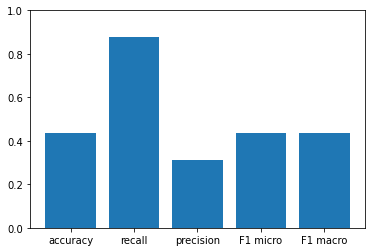

************************************************************************************
************************************************************************************
Classifier   :    KNeighbors k=1
Accuracy     :    0.6569037656903766
Recall       :    0.3939393939393939
Precision    :    0.38235294117647056
F1 micro     :    0.6569037656903766
F1 macro     :    0.5748438042346408


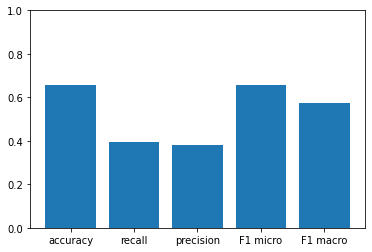

************************************************************************************
######################################################################################################
######################################################################################################
                                      For     patient_00001000-100507
######################################################################################################
######################################################################################################
************************************************************************************
Classifier   :    GaussianNB
Accuracy     :    0.36134453781512604
Recall       :    0.8297872340425532
Precision    :    0.21311475409836064
F1 micro     :    0.36134453781512604
F1 macro     :    0.36062212796041004


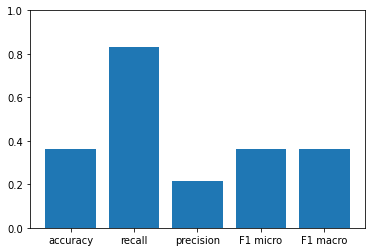

************************************************************************************
************************************************************************************
Classifier   :    KNeighbors k=1
Accuracy     :    0.7184873949579832
Recall       :    0.3829787234042553
Precision    :    0.32142857142857145
F1 micro     :    0.7184873949579833
F1 macro     :    0.5849449491137197


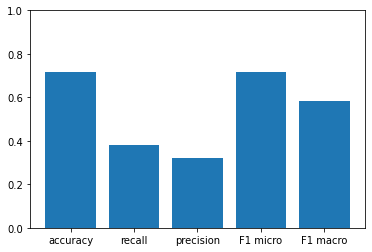

************************************************************************************
######################################################################################################
######################################################################################################
                                      For     patient_00001008-100507
######################################################################################################
######################################################################################################
######################################################################################################
######################################################################################################
                                      For     patient_00001006-100507
######################################################################################################
######################################################

In [109]:
test_all_patients_seperately(clfs)

# Deep Leaning aproach

Μη ευχαριστημένοι με τα αποτελέσματα, αποφασίσαμε να δοκιμάσουμε μία διαφορετική τεχνική, βασισμένη στο εξής [tutorial](https://www.youtube.com/playlist?list=PL-wATfeyAMNrtbkCNsLcpoAyBBRJZVlnf). Για να το πετύχουμε αυτό θα χρειαστούμε δοδεμένα σε μορφή WAV και όχι csv. Οπότε κατεβάσαμε το EDF to WAV conveter.




![picture](https://drive.google.com/uc?export=view&id=17K87LxAv1dtzRJR4d-Ylpa5vzfds03c4)

# Imports

In [110]:
import IPython
from pydub import AudioSegment
import librosa, librosa.display
import tensorflow.keras as keras

from sklearn.model_selection import train_test_split


Παρόμοια με την προηγούμενη προσπάθεια, θα χωρίσουμε τα αρχεία μας σε κομμάτια των 20 δευτερολέπτων. Η συνάρτηση split_wavs έχει πολύ παρόμοια δομή με τον fft_generator, έχουμε τους φακέλους μας, τα offset , start, leftover, end, store κτλ. 

In [111]:
def split_wavs():
  for patient_folder in os.listdir(project_folder):
    target_folder =  project_folder+'/'+patient_folder+ "/split_wavs"
    make_folder(target_folder)

    time_step = 20000 # 20 second 

    for input_wav_file in os.listdir(project_folder+'/'+patient_folder+"/WAVs/"):
      wav =  project_folder+'/'+patient_folder+"/WAVs/" +input_wav_file
      # # patient = input_wav_file[:-9]
      trial = input_wav_file[-6:-5]
      time_offset = (int(trial)-1) *3600 *10**3 ## every other trial is an hour after the preious
      totalAudio = AudioSegment.from_wav(wav)
      size_in_ms =len(totalAudio)
   
      complete_intrvals = size_in_ms // time_step
      for i in range(complete_intrvals):
        start =i*time_step 
        end = start + time_step
        newAudio = totalAudio[start:end]
        target_file = target_folder+'/start_'+str((start+time_offset)//1000)+'_end_'+str((end+time_offset)//1000)+'_.wav'
        newAudio.export(target_file, format="wav") 
        if len(newAudio) ==0 :
          print('Eror at audio ',wav,trial,start,end)
          break
      
      leftovers = size_in_ms%(complete_intrvals *time_step) 
      if leftovers > 1000:
        start = end 
        end = start -time_step+ leftovers
        newAudio = totalAudio[start:end]
        target_file = target_folder+'/start_'+str((start+time_offset)//1000)+'_end_'+str((end+time_offset)//1000)+'_.wav'
        newAudio.export(target_file, format="wav") 
      



In [ ]:
#split_wavs()

## Visualize

In [112]:
def visualize_wav(wav_file):
  signal, sr = librosa.load(wav_file,sr=48000)
  librosa.display.waveplot(signal,sr=sr)
  plt.xlabel("time")
  plt.ylabel('Amplitude')
  plt.show()


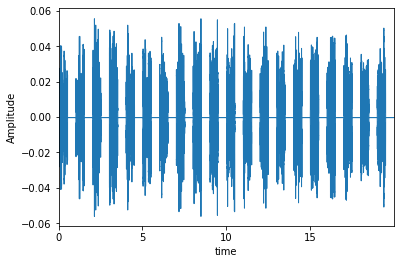

In [113]:
wav_file  = 'drive/MyDrive/team_10/patient_00001008-100507/split_wavs/start_2300_end_2320_.wav'

visualize_wav(wav_file)
IPython.display.Audio(wav_file) # This is required on Google Colab due to compatibility issues


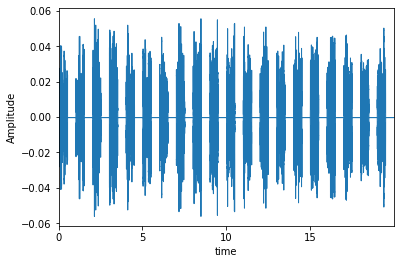

In [114]:
wav_file ="drive/MyDrive/team_10/patient_00001008-100507/split_wavs/start_2300_end_2320_.wav"
visualize_wav(wav_file)

IPython.display.Audio(wav_file) # This is required on Google Colab due to compatibility issues


Παρατήρούμε ότι για κάποιον λόγο, το edf to wav exctraction δεν έχει γίνει σωστά, καθώς κάθε 0.5 seconds έχουμε απουσία ήχου, παρόλο που και το csv αρχείο και το waveform στους edfviewrs δεν παρουσιάζουν τέτοιο φαινόμενο.


![picture](https://drive.google.com/uc?export=view&id=1gd-0BeeIfBxQXvdrtFq_gRUmc_Jc3oV0)

### Speaking

Τυχαία πέσαμε πάνω σε μερικά δείγματα στα οποία μπορούμε να ακούσεμε τους γιατρούς (μάλλον) να μιλάνε

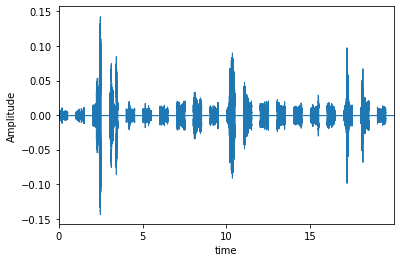

In [115]:
speaking_wav_file ="drive/MyDrive/team_10/patient_00001000-100507/split_wavs/start_14680_end_14700_.wav"


visualize_wav(speaking_wav_file)
IPython.display.Audio(speaking_wav_file) # This is required on Google Colab due to compatibility issues


In [117]:
def match_apnea_events_to_wav(patient_folder):
  split_wav_file = project_folder + '/'+patient_folder+'/split_wavs'
  samples =[]
  for wav_sample in os.listdir(split_wav_file):
    split = wav_sample.split('_')
    sample ={}
    sample['Start'] = int(split[1])
    sample['period_end'] = int(split[3])
    sample['wav_file'] = split_wav_file+ '/' +wav_sample
    sample['audio'] = AudioSegment.from_wav(split_wav_file+ '/' +wav_sample)
    sample['label'] = 0
    samples.append(sample)
  
  samples.sort(key=lambda x:x['Start'])
  apnea_events =  find_apnea_events(patient_folder[8:])
  match_apnea_events_to_samples(samples,apnea_events)
  return samples


### Νormal events

Θα ακούσουμε μερικά σημεία που δεν έχουμε άπνοια

In [118]:
samples = match_apnea_events_to_wav('patient_00001008-100507')
count = 0
for s in samples:
  if s['label'] ==0 :
    print(s)
    count = count +1
  if count ==10:
    break

{'Start': 0, 'period_end': 20, 'wav_file': 'drive/MyDrive/team_10/patient_00001008-100507/split_wavs/start_0_end_20_.wav', 'audio': <pydub.audio_segment.AudioSegment object at 0x7f8f365e2290>, 'label': 0}
{'Start': 20, 'period_end': 40, 'wav_file': 'drive/MyDrive/team_10/patient_00001008-100507/split_wavs/start_20_end_40_.wav', 'audio': <pydub.audio_segment.AudioSegment object at 0x7f8f35cf6ed0>, 'label': 0}
{'Start': 40, 'period_end': 60, 'wav_file': 'drive/MyDrive/team_10/patient_00001008-100507/split_wavs/start_40_end_60_.wav', 'audio': <pydub.audio_segment.AudioSegment object at 0x7f8f36439e10>, 'label': 0}
{'Start': 60, 'period_end': 80, 'wav_file': 'drive/MyDrive/team_10/patient_00001008-100507/split_wavs/start_60_end_80_.wav', 'audio': <pydub.audio_segment.AudioSegment object at 0x7f8f35e132d0>, 'label': 0}
{'Start': 80, 'period_end': 100, 'wav_file': 'drive/MyDrive/team_10/patient_00001008-100507/split_wavs/start_80_end_100_.wav', 'audio': <pydub.audio_segment.AudioSegment obje

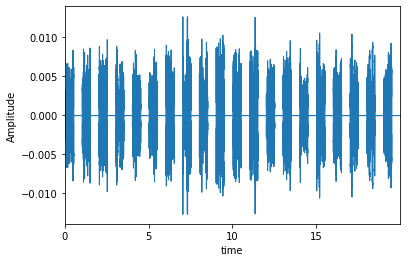

In [119]:
wav_file = 'drive/MyDrive/team_10/patient_00001008-100507/split_wavs/start_0_end_20_.wav'
visualize_wav(wav_file)
IPython.display.Audio(wav_file) 

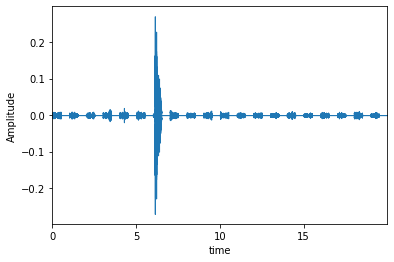

In [120]:
wav_file = 'drive/MyDrive/team_10/patient_00001008-100507/split_wavs/start_140_end_160_.wav'
visualize_wav(wav_file)
IPython.display.Audio(wav_file) 

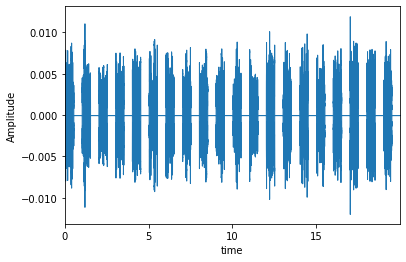

In [121]:
wav_file = 'drive/MyDrive/team_10/patient_00001008-100507/split_wavs/start_180_end_200_.wav'
visualize_wav(wav_file)
IPython.display.Audio(wav_file) 

###Αpnea events

Θα ακούσουμε μερικά σημεία που  έχουμε άπνοια

In [122]:
count = 0
for s in samples:
  if s['label'] ==1 :
    print(s)
    count = count +1
  if count ==10:
    break

{'Start': 1980, 'period_end': 2000, 'wav_file': 'drive/MyDrive/team_10/patient_00001008-100507/split_wavs/start_1980_end_2000_.wav', 'audio': <pydub.audio_segment.AudioSegment object at 0x7f8f36dd5750>, 'label': 1}
{'Start': 2000, 'period_end': 2020, 'wav_file': 'drive/MyDrive/team_10/patient_00001008-100507/split_wavs/start_2000_end_2020_.wav', 'audio': <pydub.audio_segment.AudioSegment object at 0x7f8f36dd5850>, 'label': 1}
{'Start': 2040, 'period_end': 2060, 'wav_file': 'drive/MyDrive/team_10/patient_00001008-100507/split_wavs/start_2040_end_2060_.wav', 'audio': <pydub.audio_segment.AudioSegment object at 0x7f8f36dd5f50>, 'label': 1}
{'Start': 2060, 'period_end': 2080, 'wav_file': 'drive/MyDrive/team_10/patient_00001008-100507/split_wavs/start_2060_end_2080_.wav', 'audio': <pydub.audio_segment.AudioSegment object at 0x7f8f2794e0d0>, 'label': 1}
{'Start': 2080, 'period_end': 2100, 'wav_file': 'drive/MyDrive/team_10/patient_00001008-100507/split_wavs/start_2080_end_2100_.wav', 'audio'

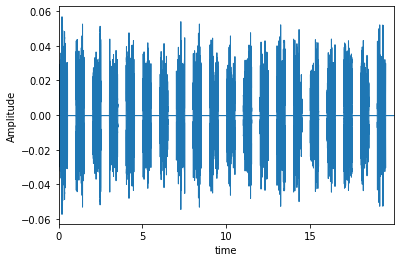

In [123]:
wav_file ="drive/MyDrive/team_10/patient_00001008-100507/split_wavs/start_1980_end_2000_.wav"
visualize_wav(wav_file)
IPython.display.Audio(wav_file) 

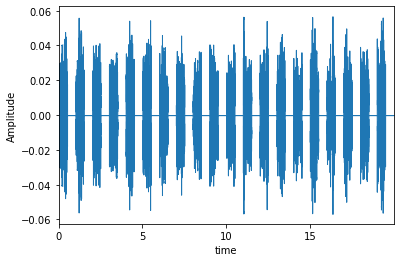

In [124]:
wav_file ="drive/MyDrive/team_10/patient_00001008-100507/split_wavs/start_2080_end_2100_.wav"
visualize_wav(wav_file)
IPython.display.Audio(wav_file) 

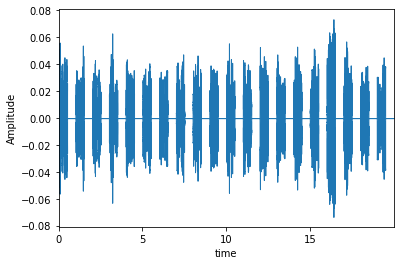

In [125]:
wav_file ="drive/MyDrive/team_10/patient_00001008-100507/split_wavs/start_4840_end_4860_.wav"
visualize_wav(wav_file)
IPython.display.Audio(wav_file) 

## Χαμένες τιμές

Καθώς λοιπόν έχουμε αυτό το τεχνικό πρόβλημα, αποφασήσαμε να πάρουμε τα δεδομένα απο το όπως πριν csv και να συμπεριφερθούμε λες και είναι αρχεία ήχου 

Αρχείο wav

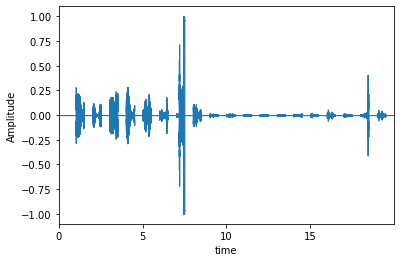

960000


In [126]:
wav_file = 'drive/MyDrive/team_10/patient_00000995-100507/split_wavs/start_0_end_20_.wav'

visualize_wav(wav_file)
signal, sr = librosa.load(wav_file,sr=48000)
print(len(signal))

Αντίστοιχη περίοδος στο csv

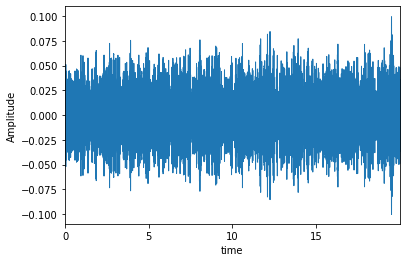

In [127]:
data_file = 'drive/MyDrive/team_10/patient_00000995-100507/csv_data/00000995-100507[001]_data.txt'

data = pd.read_csv(data_file, nrows=960000,skiprows=1,header=None)

librosa.display.waveplot(np.array(data[19]),sr=48000)
plt.xlabel("time")
plt.ylabel('Amplitude')
plt.show()

Θεωρούμε ότι καλύτερα να διαλέξουμε το dataset από τα κομμένα wav.

### mfcc

Στα deep leanring μοντέλα, δεν θα χρησιμοποιήσουμε τον απλό μετασχηματισμό Fourier, αλλά κάτι που λέγεται mfcc. Ουσιαστικά, στο δείγμα σου κάνει Fourier ανα μικρά χρονικά διαστήματα. Αυτό έχει ως αποτέλεσμα να κωδικοποιείται η χρονική ακολουθία του ήχου.

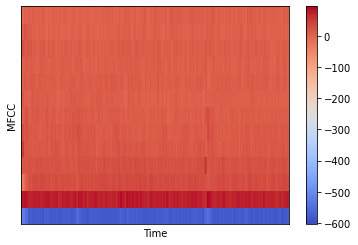

In [128]:
data_file = 'drive/MyDrive/team_10/patient_00001000-100507/csv_data/00001000-100507[001]_data.txt'

data = pd.read_csv(data_file, nrows=240000,skiprows=1,header=None)


mfcc = librosa.feature.mfcc(np.array(data[19]),sr=48000,n_fft=2048,hop_length=512,n_mfcc=13)

librosa.display.specshow(mfcc,sr=48000,hop_length=512)
plt.xlabel('Time')
plt.ylabel('MFCC')
plt.colorbar()
plt.show()

# MFCC exctraction

Η διαδικασία είναι ανάλογη με το fft extraction, με μόνη διαφορά ότι διαλέξαμε το διάστημα που θα κάνουμε κάθε μετασχηματισμό να είναι 5 seconds αντί για 20. Ο λόγος είναι ότι, κάτι που δεν είχαμε σκεφτεί είναι ότι ένα apnea event διάρκειας 10, εάν τα πρώτα 5 δευτερόλεπτα είναι σε ένα διάστημα και τα 5 επόμενα σε άλλο, θα χάσουμε πληροφορία, καθώς τα διαστήματα που θα γίνουν label ως apnea event, θα έχουν στην πραγματικότητα περισσότερη διάρκεια κανονικού ύπνου. Άρα σε αυτήν την προσέγγιση, τα apnea events θα περιέχουν πολλά samples το καθένα. Στα samples αυτά, η διάρκεια που θα έχουμε apnea event θα είναι μεγαλύτερη από αυτή που δεν έχουμε. Η διάρκεια του sample ορίζεται από την μεταβλητή rows_in_each_sample, με κάθε row να είναι 1/48000 secons

In [72]:
def dump_mfcc_information(data,file,time_offset,sr=48000,n_mfcc=13, n_fft=2048, hop_length=512):
    information ={}
    information["start"] = data[0].iloc[0]+time_offset
    information["period_end"] = data[0].iloc[-1]+time_offset
    mfcc = librosa.feature.mfcc(np.array(data[19]),sr,n_mfcc=n_mfcc,n_fft=n_fft,hop_length=hop_length)
    information['mfcc'] = mfcc.T

    with open(file, 'wb') as fp:
      pickle.dump(information, fp)


In [73]:
def mfcc_generator(file,trial,folder,patient,rows_in_each_sample,batches,leftovers,skiprows=0):
  n = rows_in_each_sample
  total_rows = batches * rows_in_each_sample
  #each trial is an hour long
  time_offset = (int(trial)-1) *3600
  # the first time we take the header from the file
  data = pd.read_csv(file, nrows=n,skiprows=1,header=None)
  dump_mfcc_information(data,folder+ '/'+ patient + '_mfcc_0.pkl',time_offset)
  # and return true so the genetatro knows that there is more to come
  yield True

  # we repeate the same for all the rows
  skiprows = skiprows+ n 
  while skiprows < total_rows :

    # header = NONE cause we read from the middle of the file
    data = pd.read_csv(file, nrows=n,skiprows=skiprows,header=None)
    filename =folder + '/'+ patient + '_mfcc_' +str(int(skiprows/rows_in_each_sample))+'.pkl'
    dump_mfcc_information(data,filename,time_offset)
    skiprows = skiprows+ n 
    yield  True
  # now we just have to read the the leftovers


  if leftovers > 100:

    information = {}
    data = pd.read_csv(file, nrows=leftovers,skiprows=skiprows,header=None)
    filename = folder + '/'+ patient + '_mfcc_' +str(1+int(skiprows/rows_in_each_sample))+'.pkl'
    dump_mfcc_information(data,filename,time_offset)
    yield  False
  #so it does not crash
  while True:
    yield False



In [74]:
# nothing new, a helper function that calls every important cell from above, so we dont have to run everything
def perform_mfcc_on_csv(patients,trials,rows_in_each_sample = 240000):
  for patient in patients:
    patient_folder = project_folder+ "/patient_" + patient
    make_folder(patient_folder)
    csv_data_folder = patient_folder + '/csv_data'
    make_folder(csv_data_folder)

    for trial in trials:
      data_filename = csv_data_folder+ '/'+ patient + '['+trial+']' +'_data.txt'
      # folder to  store the mfccs 
      mfccs_folder = patient_folder + '/mfccs'
      make_folder(mfccs_folder)

      mfccs_trial_folder = mfccs_folder +'/'+trial
      make_folder(mfccs_trial_folder)

      count = count_rows(data_filename)
      batches = int(count /rows_in_each_sample)
      leftovers = count%(batches *rows_in_each_sample) - 1 

      g = mfcc_generator(data_filename,trial,mfccs_trial_folder,patient,rows_in_each_sample,batches,leftovers)

      while(next(g)):
        pass

In [129]:
patients = ['00000995-100507','00001000-100507','00000999-100507']
trials = ['002','003','004','005','001']
#perform_mfcc_on_csv(patients,trials)


#Label mfccs with apnea events

In [155]:
len(apnea_events)

129

In [156]:
def match_short_apnea_events_to_samples(samples,apnea_events,min_overlap=2):
  apnea_pointer = 0
  for i in range(len(samples)-1):
    if samples[i]['start'] -  apnea_events['Start'][apnea_pointer] >min_overlap:
      samples[i]['label'] =1
      next_apnea_event = True
      j = i
      while apnea_events['Start'][apnea_pointer] + apnea_events['Duration'][apnea_pointer]  -samples[j]['period_end'] > min_overlap:
        samples[j]['label'] =1
        j = j +1
        if j>len(apnea_events):
          return
      apnea_pointer = apnea_pointer +1

    



In [134]:
def get_single_patient_mfccs(patient_folder):
  patient_mfccs = []
  apnea_events = find_apnea_events(patient_folder[8:])
  mfccs_folder = project_folder+'/'+patient_folder+'/mfccs'

  if os.path.isdir(mfccs_folder):
    for trial in os.listdir(mfccs_folder):
      for mfcc in os.listdir(mfccs_folder+'/'+trial):
        with open(mfccs_folder+'/'+trial+'/'+mfcc,'rb') as file:
          x = pickle.load(file)
          x['label'] = 0
          patient_mfccs.append(x)
    patient_mfccs = sorted(patient_mfccs, key=lambda d: d['start'],reverse=False) 
    match_short_apnea_events_to_samples(patient_mfccs,apnea_events)

  return patient_mfccs

In [188]:
def create_mfcc_dataset():
  mfccs =[]
  for patient_folder in  os.listdir(project_folder):
    patient_mfccs = get_single_patient_mfccs(patient_folder)
    mfccs = mfccs + patient_mfccs
  
  Xs = np.array([mfccs[0]['mfcc']])
  ys = np.array([mfccs[0]['label']])
  
  for f in mfccs:
    Xs = np.append(Xs,[f['mfcc']], axis = 0)
    ys = np.append(ys,[f['label']],axis = 0)
  
  return Xs, ys



In [221]:
def plot_history_acc(history):
  # summarize history for accuracy
  plt.plot(history.history['accuracy'])
  plt.plot(history.history['val_accuracy'])
  plt.title('model accuracy')
  plt.ylabel('accuracy')
  plt.xlabel('epoch')
  plt.legend(['train', 'test'], loc='upper left')
  plt.show()

In [222]:
def plot_history_loss(history):  # summarize history for accuracy
  plt.plot(history.history['loss'])
  plt.plot(history.history['val_loss'])
  plt.title('model loss')
  plt.ylabel('loss')
  plt.xlabel('epoch')
  plt.legend(['train', 'test'], loc='upper left')
  plt.show()

In [246]:
def get_model_history(model,X,labels,
                      test_size=0.3,epochs=10,batch_size=32,
                      optimiser = keras.optimizers.Adam(learning_rate=0.0001),
                      loss='binary_crossentropy',verbose=1):
  # https://github.com/musikalkemist/DeepLearningForAudioWithPython/blob/master/13-%20Implementing%20a%20neural%20network%20for%20music%20genre%20classification/code/mlp_genre_classifier.py
  X_train, X_test, y_train, y_test = train_test_split(X, labels, test_size=test_size)
  # build network topology
  # compile model
  model = simple_NN(X.shape[1],X.shape[2])

  model.compile(optimizer=optimiser,
                loss=loss,
                metrics=['accuracy'])
  # train model
  history = model.fit(X_train, y_train, validation_data=(X_test, y_test), batch_size=batch_size, epochs=epochs,verbose=verbose)

  return history

## Simple NN

In [239]:
def simple_NN(dim_1,dim_2):
  return keras.Sequential([
    # input layer
    keras.layers.Flatten(input_shape=(dim_1,dim_2)),
    # 1st dense layer
    keras.layers.Dense(512, activation='relu'),
    # 2nd dense layer
    keras.layers.Dense(256, activation='relu'),
    # 3rd dense layer
    keras.layers.Dense(64, activation='relu'),
    # output layer
    keras.layers.Dense(1, activation='softmax')
])

In [240]:
X, labels = create_mfcc_dataset()

In [241]:
model = simple_NN(X.shape[1],X.shape[2])
model.summary()

Model: "sequential_14"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten_14 (Flatten)        (None, 24388)             0         
                                                                 
 dense_56 (Dense)            (None, 512)               12487168  
                                                                 
 dense_57 (Dense)            (None, 256)               131328    
                                                                 
 dense_58 (Dense)            (None, 64)                16448     
                                                                 
 dense_59 (Dense)            (None, 1)                 65        
                                                                 
Total params: 12,635,009
Trainable params: 12,635,009
Non-trainable params: 0
_________________________________________________________________


In [242]:
simple_NN_history = get_model_history(model,X,labels)

Epoch 1/10
135/135 [==============================] - 10s 72ms/step - loss: 32.7652 - accuracy: 0.2185 - val_loss: 21.2588 - val_accuracy: 0.2308
Epoch 2/10
135/135 [==============================] - 10s 72ms/step - loss: 26.6350 - accuracy: 0.2185 - val_loss: 4.2284 - val_accuracy: 0.2308
Epoch 3/10
135/135 [==============================] - 10s 71ms/step - loss: 14.5563 - accuracy: 0.2185 - val_loss: 5.9621 - val_accuracy: 0.2308
Epoch 4/10
135/135 [==============================] - 10s 71ms/step - loss: 9.4787 - accuracy: 0.2185 - val_loss: 10.3840 - val_accuracy: 0.2308
Epoch 5/10
135/135 [==============================] - 12s 87ms/step - loss: 10.7863 - accuracy: 0.2185 - val_loss: 9.9196 - val_accuracy: 0.2308
Epoch 6/10
135/135 [==============================] - 10s 74ms/step - loss: 10.2131 - accuracy: 0.2185 - val_loss: 2.7929 - val_accuracy: 0.2308
Epoch 7/10
135/135 [==============================] - 10s 71ms/step - loss: 4.3081 - accuracy: 0.2185 - val_loss: 1.4049 - val_ac

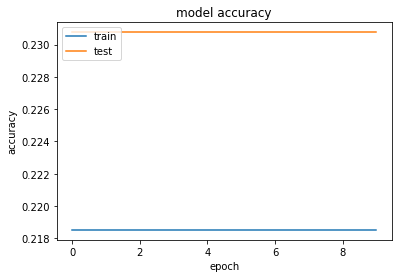

In [243]:
plot_history_acc(simple_NN_history)

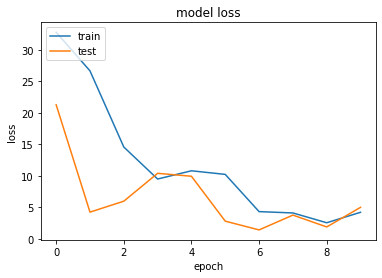

In [244]:
plot_history_loss(simple_NN_history)

In [245]:
model = simple_NN(X.shape[1],X.shape[2])
simple_NN_history = get_model_history(model,X,labels,optimiser='SGD')

Epoch 1/10
135/135 [==============================] - 6s 41ms/step - loss: nan - accuracy: 0.7704 - val_loss: nan - val_accuracy: 0.7607
Epoch 2/10
135/135 [==============================] - 6s 43ms/step - loss: nan - accuracy: 0.7852 - val_loss: nan - val_accuracy: 0.7607
Epoch 3/10
135/135 [==============================] - 5s 40ms/step - loss: nan - accuracy: 0.7852 - val_loss: nan - val_accuracy: 0.7607
Epoch 4/10
135/135 [==============================] - 5s 38ms/step - loss: nan - accuracy: 0.7852 - val_loss: nan - val_accuracy: 0.7607
Epoch 5/10
135/135 [==============================] - 5s 39ms/step - loss: nan - accuracy: 0.7852 - val_loss: nan - val_accuracy: 0.7607
Epoch 6/10
135/135 [==============================] - 5s 38ms/step - loss: nan - accuracy: 0.7852 - val_loss: nan - val_accuracy: 0.7607
Epoch 7/10
135/135 [==============================] - 5s 38ms/step - loss: nan - accuracy: 0.7852 - val_loss: nan - val_accuracy: 0.7607
Epoch 8/10
135/135 [=====================

##CNN

In [ ]:
#https://github.com/musikalkemist/DeepLearningForAudioWithPython/blob/master/16-%20How%20to%20implement%20a%20CNN%20for%20music%20genre%20classification/code/cnn_genre_classifier.py
def build_cnn(input_shape):
    """Generates CNN model
    :param input_shape (tuple): Shape of input set
    :return model: CNN model
    """

    # build network topology
    model = keras.Sequential()

    # 1st conv layer
    model.add(keras.layers.Conv2D(32, (3, 3), activation='relu', input_shape=input_shape))
    model.add(keras.layers.MaxPooling2D((3, 3), strides=(2, 2), padding='same'))
    model.add(keras.layers.BatchNormalization())

    # 2nd conv layer
    model.add(keras.layers.Conv2D(32, (3, 3), activation='relu'))
    model.add(keras.layers.MaxPooling2D((3, 3), strides=(2, 2), padding='same'))
    model.add(keras.layers.BatchNormalization())

    # 3rd conv layer
    model.add(keras.layers.Conv2D(32, (2, 2), activation='relu'))
    model.add(keras.layers.MaxPooling2D((2, 2), strides=(2, 2), padding='same'))
    model.add(keras.layers.BatchNormalization())

    # flatten output and feed it into dense layer
    model.add(keras.layers.Flatten())
    model.add(keras.layers.Dense(64, activation='relu'))
    model.add(keras.layers.Dropout(0.3))

    # output layer
    model.add(keras.layers.Dense(1, activation='softmax'))

    return model

##RNN-LSTM

In [ ]:
#https://github.com/musikalkemist/DeepLearningForAudioWithPython/blob/master/19-%20How%20to%20implement%20an%20RNN-LSTM%20for%20music%20genre%20classification/code/19-%20How%20to%20implement%20an%20RNN-LSTM%20for%20music%20genre%20classification.py
def build_rnn(input_shape):
    """Generates RNN-LSTM model
    :param input_shape (tuple): Shape of input set
    :return model: RNN-LSTM model
    """

    # build network topology
    model = keras.Sequential()

    # 2 LSTM layers
    model.add(keras.layers.LSTM(64, input_shape=input_shape, return_sequences=True))
    model.add(keras.layers.LSTM(64))

    # dense layer
    model.add(keras.layers.Dense(64, activation='relu'))
    model.add(keras.layers.Dropout(0.3))

    # output layer
    model.add(keras.layers.Dense(10, activation='softmax'))

    return model

#References

[1]PSG-Audio, a scored polysomnography dataset with simultaneous audio recordings for sleep apnea studies

[2] The Frequency and Energy of
Snoring Sounds Are Associated
with Common Carotid Artery
Intima-Media Thickness in
Obstructive Sleep Apnea Patients